## 프로젝트 1 : 직접 고른 이미지로 SRGAN 실험하기

### 프로젝트 1-1.

**필요한 라이브러리 import**

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import os
import imageio
from IPython.display import Image as show_gif
from IPython.display import display

**1. (적당히) 높은 해상도를 가진 이미지를 검색해서 한 장 고른 후 저장하고 불러옵니다.**

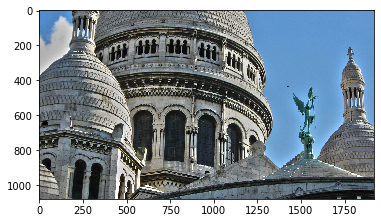

In [2]:
img = cv2.imread("./images/image_hr.jpg")
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.show()

In [3]:
img.shape

(1080, 1920, 3)

**2. 불러온 이미지에 bicubic interpolation을 적용해 가로 및 세로 픽셀 수를 1/4로 줄입니다. cv2.resize()를 사용해 봅시다.**

In [4]:
height, width, _ = img.shape
img_lr = cv2.resize(img, (width//4, height//4), interpolation = cv2.INTER_CUBIC)
img_lr.shape

(270, 480, 3)

**3. 줄인 저해상도 이미지를 입력으로 SRGAN을 이용해 고해상도 이미지를 생성합니다. 이전에 사용한 apply_srgan 함수를 사용하면 쉽습니다.**

In [5]:
# 사전에 학습된 srgan 모델 호출

srgan = tf.keras.models.load_model('./models/srgan_G.h5')

In [6]:
# 저해상도 이미지에 srgan을 적용하는 함수 정의

def apply_srgan(image):
    image = tf.cast(image[np.newaxis, ...], tf.float32)
    sr = srgan.predict(image)
    sr = tf.clip_by_value(sr, 0, 255)
    sr = tf.round(sr)
    sr = tf.cast(sr, tf.uint8)
    return np.array(sr)[0]

In [7]:
img_srg = apply_srgan(img_lr)

**4. 2.의 이미지에 bicubic interpolation을 적용해 가로 및 세로 픽셀 수를 다시 4배로 늘립니다. 마찬가지로 cv2.resize()를 사용해 봅시다.**

In [10]:
height, width, _ = img_lr.shape
img_bc = cv2.resize(img_lr, (width*4, height*4), interpolation = cv2.INTER_CUBIC)

**5. 3개 이미지(4.의 Bicubic의 결과, 3.의 SRGAN의 결과, 1.의 원래 고해상도 이미지)를 나란히 시각화합니다. 각 이미지의 제목에 어떤 방법에 대한 결과인지 표시해 주세요. 이전 시각화에 사용했던 코드를 참고하면 어렵지 않습니다.**

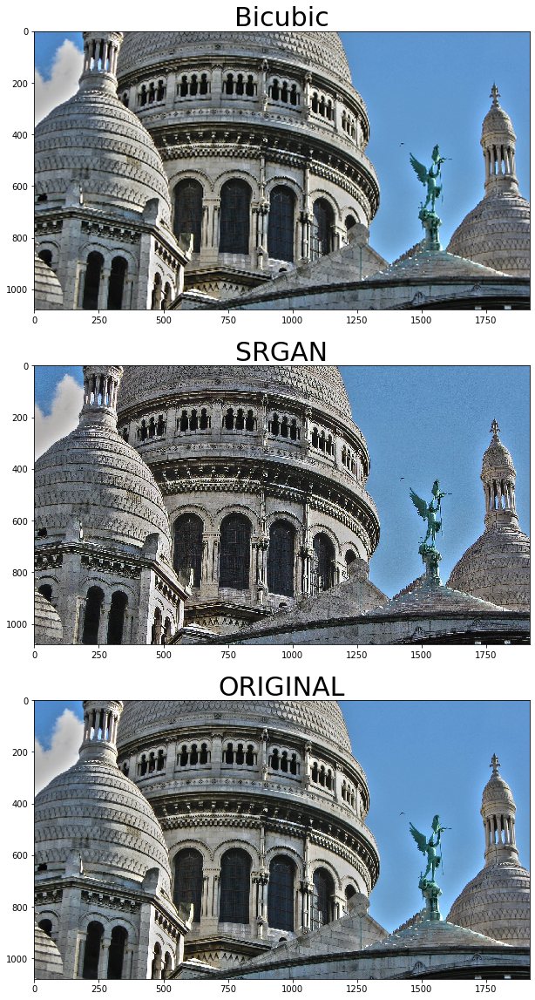

In [11]:
images = [img_bc, img_srg, img]
labels = ["Bicubic", "SRGAN", "ORIGINAL"]

plt.figure(figsize=(20,20))
for i in range(3):
    plt.subplot(3,1,i+1) 
    plt.imshow(cv2.cvtColor(images[i], cv2.COLOR_BGR2RGB))
    plt.title(labels[i], fontsize=30)

In [12]:
# 이미지의 특정 부분을 잘라내는 함수 정의

def crop(image, left_top, x=200, y=200):
    return image[left_top[0]:(left_top[0]+x), left_top[1]:(left_top[1]+y), :]

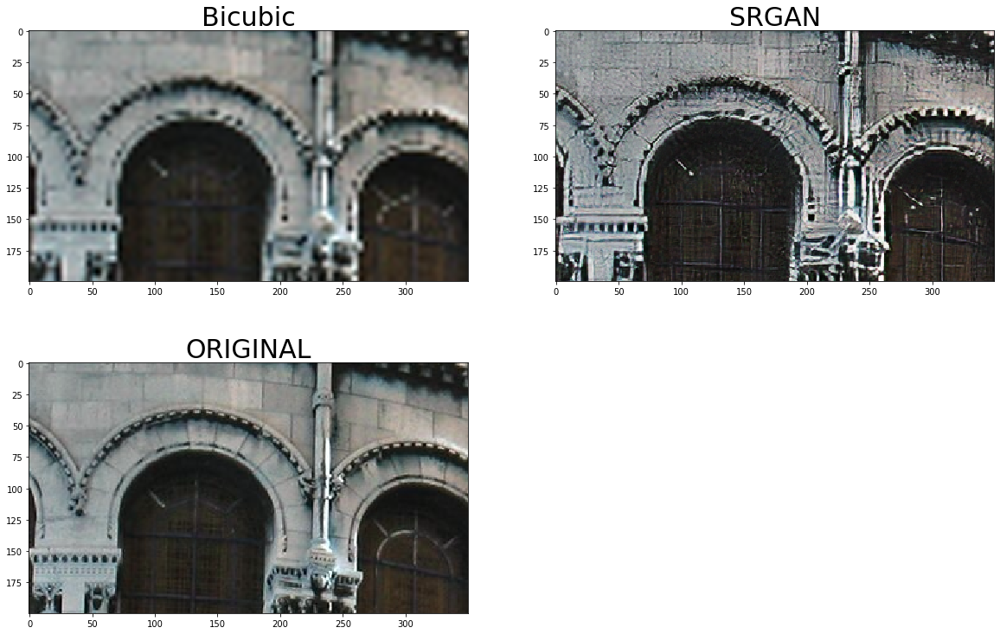

In [13]:
left_top = (500, 650) # 잘라낼 부분의 왼쪽 상단 좌표를 지정합니다.

plt.figure(figsize=(20,20))
for i, pind in enumerate([321, 322, 323]):
    plt.subplot(pind)
    plt.imshow(crop(images[i], left_top, 200, 350))
    plt.title(labels[i], fontsize=30)

**6. 선택한 이미지를 DIV2K 데이터셋에서 학습된 모델로 Super Resolution했을 때 어떠한 결과가 나왔으며, 왜 이러한 결과가 출력되었는지 설명해 봅시다. (정답은 없습니다)**

결과적으로, Bicubic interpolation 방식을 적용했을 땐 원본 이미지보다 전체적으로 흐린 이미지가 됐고, SRGAN은 선명하지만 자연스럽지 못하고 인위적이게 선명한 이미지가 됐으며, 저해상도 이미지에서 주변과 구분되지만 그 구분이 명확하지 않은 부분이 사라졌다.   
우선 bicubic interpolation은 채워야 할 픽셀의 정보를 주변 픽셀들을 활용해 구하며, 결국 채울 픽셀의 값은 주변 점에 특정 가중치값을 곱한 값이 된다고 생각한다.   
이 때문에 주변 픽셀과의 경계가 뚜렷하지 않을 것이므로 흐린 이미지가 나오는 것 같다.   
SRGAN은 GAN과 같은 구조를 가지므로, 학습 과정에서 생성자가 더 선명한(해상도가 높은) 이미지를 생성하도록 학습됐을 것이다.   
이번 프로젝트에선 학습된 모델을 가져다 썼으므로 어떤 데이터를 학습했는지 알 수 없지만, 좀 더 학습 데이터와 유사한 이미지라면 인위적인 느낌이 줄고 건물의 특정 부분이 사라지는 일이 덜 발생할 것 같다.

### 프로젝트 1-2.

**1. (적당히) 낮은 해상도를 가진 이미지를 검색해서 한 장 고른 후 저장하고 불러옵니다.**

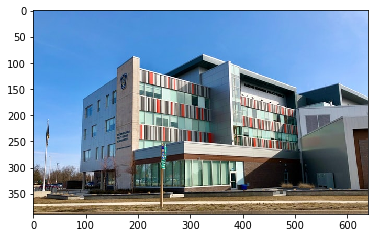

In [10]:
img = cv2.imread("./images/image_lr.jpg")
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.show()

In [11]:
img.shape

(389, 640, 3)

**2. 불러온 이미지를 입력으로 SRGAN을 이용해 고해상도 이미지를 생성합니다. 이전에 사용한 apply_srgan 함수를 사용하면 쉽습니다.**

In [13]:
img_srg = apply_srgan(img)

**3. 1.에서 불러온 이미지에 bicubic interpolation을 적용해 가로 및 세로 픽셀 수를 다시 4배로 늘립니다. cv2.resize()를 사용해 봅시다.**

In [16]:
height, width, _ = img.shape
img_bc = cv2.resize(img, (width*4, height*4), interpolation = cv2.INTER_CUBIC)
img_bc.shape

(1556, 2560, 3)

**4. 2개 이미지(3.의 Bicubic의 결과, 2.의 SRGAN의 결과)를 나란히 시각화합니다. 각 이미지의 제목에 어떤 방법에 대한 결과인지 표시해 주세요. 이전 시각화에 사용했던 코드를 참고하면 어렵지 않습니다.**

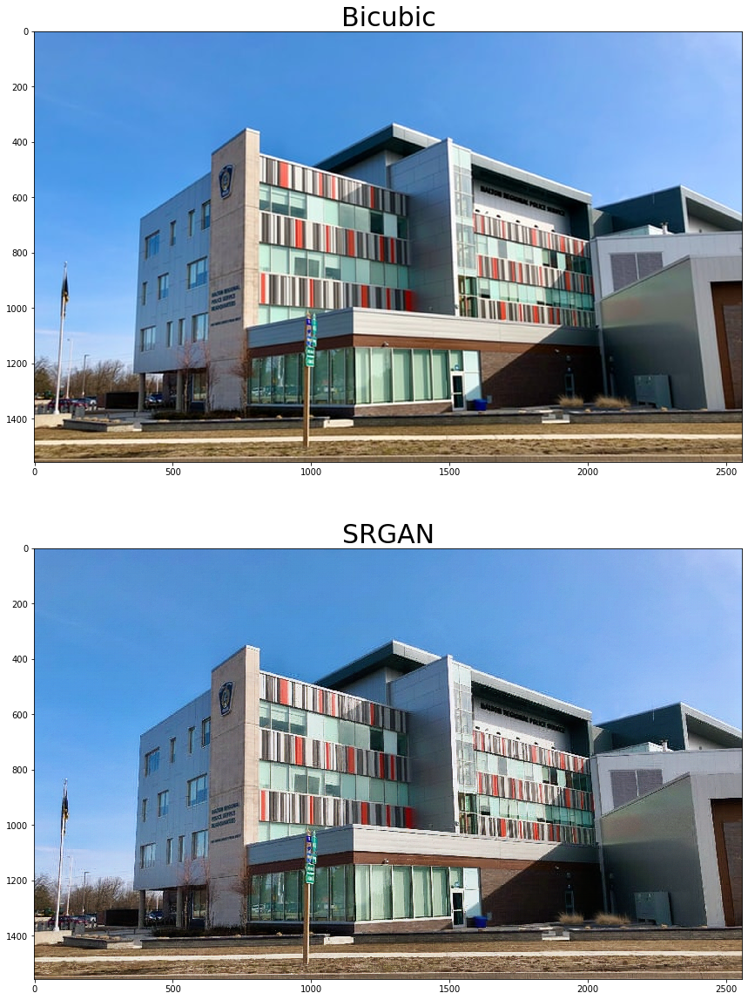

In [17]:
images = [img_bc, img_srg]
labels = ["Bicubic", "SRGAN"]

plt.figure(figsize=(20,20))
for i in range(2):
    plt.subplot(2,1,i+1) 
    plt.imshow(cv2.cvtColor(images[i], cv2.COLOR_BGR2RGB))
    plt.title(labels[i], fontsize=30)

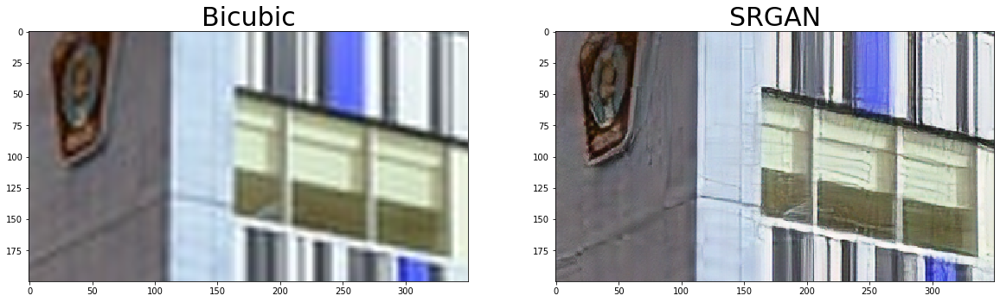

In [23]:
left_top = (500, 650) # 잘라낼 부분의 왼쪽 상단 좌표를 지정합니다.

plt.figure(figsize=(20,20))
for i, pind in enumerate([321, 322]):
    plt.subplot(pind)
    plt.imshow(crop(images[i], left_top, 200, 350))
    plt.title(labels[i], fontsize=30)

**5. 선택한 이미지를 DIV2K 데이터셋에서 학습된 모델로 Super Resolution했을 때 어떠한 결과가 나왔으며, 왜 이러한 결과가 출력되었는지 설명해 봅시다. (정답은 없습니다)**   
   


프로젝트 1-1의 결과와 마찬가지로 Bicubic interpolation 방식을 적용했을 땐 흐린 이미지가 됐고, SRGAN을 적용했을 땐 선명하지만 인위적이게 선명한 이미지가 됐다.   
이유는 위와 같다.

## 프로젝트 2 : SRGAN을 이용해 고해상도 gif 생성하기

### gif 파일 불러오기

In [89]:
gif = cv2.VideoCapture("./gifs/city_night_lr.gif")

isTrue = True
frames = []
while isTrue:
    isTrue, frame = gif.read()
    if isTrue:
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        frames.append(frame)

print("frame 수 :", len(frames))
print("frame 크기 :", (frames[0].shape))

frame 수 : 8
frame 크기 : (255, 500, 3)


### 프레임별 Super Resolution 진행하기

In [68]:
# bicubic interpolation을 이용해 이미지 가로, 세로를 4배씩 증가

frames_bc = \
[cv2.resize(image, (image.shape[1]*4, image.shape[0]*4), interpolation = cv2.INTER_CUBIC) for image in frames]

In [69]:
# 각 frame을 srgan을 활용해 고화질 이미지로 변환

frames_sr = list(map(apply_srgan, frames))

### 프레임을 합쳐 gif 만들기

In [70]:
imageio.mimsave("city_night_bc.gif", frames_bc)
imageio.mimsave("city_night_sr.gif", frames_sr)

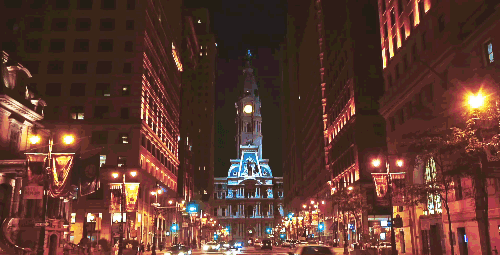

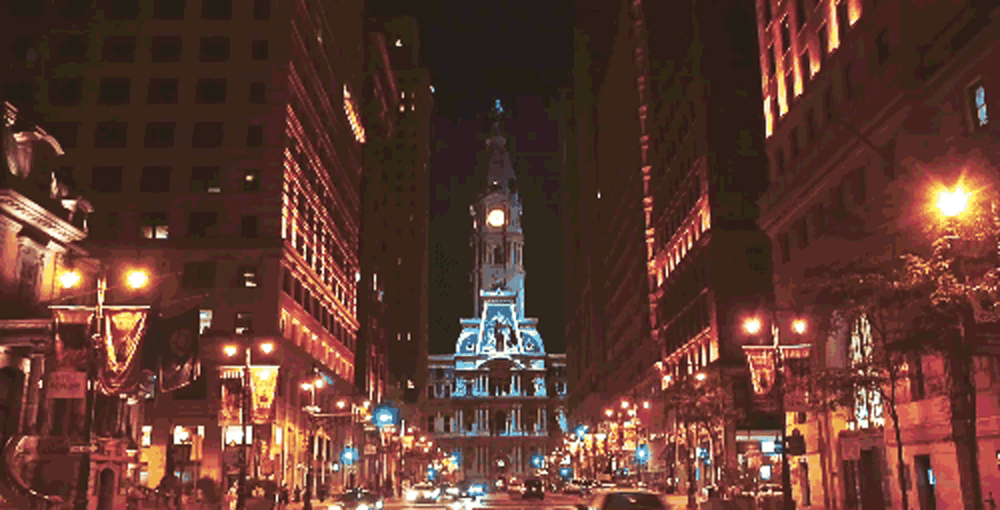

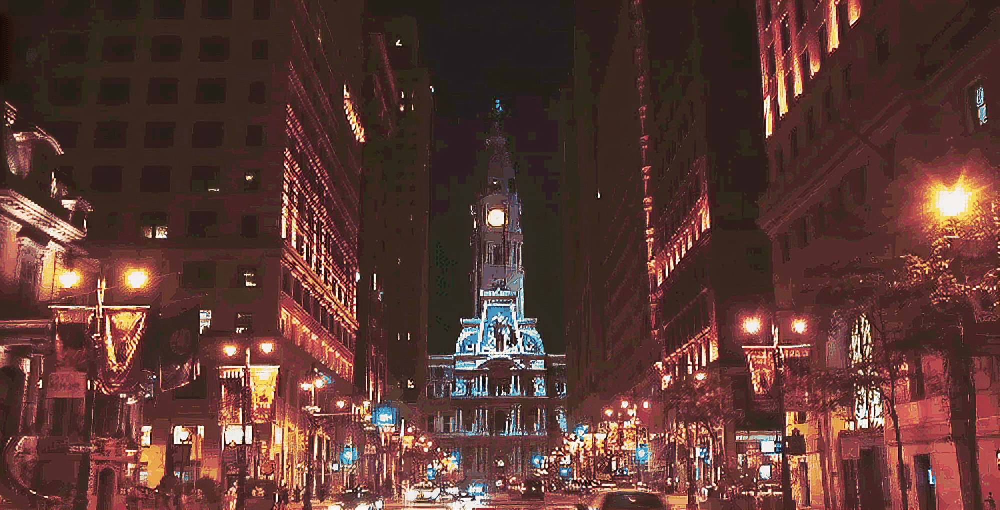

In [6]:
display(show_gif("./gifs/city_night_lr.gif", width=800), show_gif("city_night_bc.gif", width=800), show_gif("city_night_sr.gif", width=800))

<font color = 'blue'>city_night_lr.gif 외의 여러 gif 파일들도 고해상도 gif 파일로 만들었지만, ipynb 파일에 포함시키면 github 업로드 용량 제한인 100MiB를 넘기기 때문에 제외한다.</font>

### 회고   
   
   
GAN도 그렇고 유사한 구조를 사용한 SRGAN도 그렇고, 볼 때마다 신기하다.   
하지만 아직 학습 과정이 어떻게 진행되고 어떤 이유로 이런 결과가 나오는지를 설명할 수 없기 때문에 더 공부할 필요를 느낀다.   
